In [1]:
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import random
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
import sklearn
from sklearn.preprocessing import StandardScaler

import datetime

In [2]:
dark_star_input_file = "wav/DarkStarSingleVersion.wav"
#"wav/dark_star.wav"
y, sr = librosa.load(dark_star_input_file)

In [3]:
win_length_beats = 16.
bpm = 85
win_length_samples = int(60/bpm*sr*win_length_beats) #85 bpm
mfccs_T = librosa.feature.mfcc(y=y,sr=sr,n_fft = win_length_samples)

In [4]:
#mfccs_unscaled = mfccs_T.transpose()

scaler = StandardScaler()
mfccs = scaler.fit_transform(mfccs_T).transpose()
mfccs.shape

(6984, 20)

[Text(0.5, 1.0, 'MFCC')]

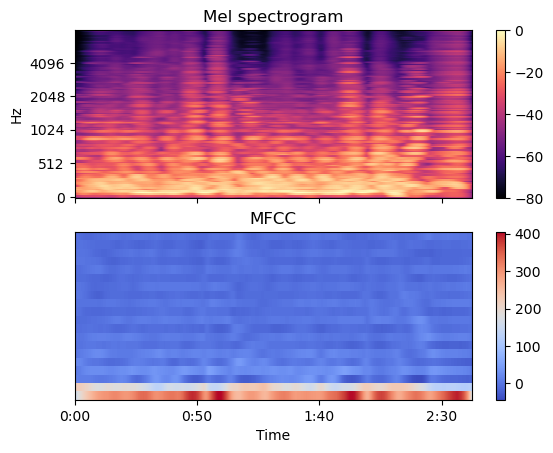

In [5]:

S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                   fmax=8000,n_fft = win_length_samples)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.power_to_db(S, ref=np.max),
                               x_axis='time', y_axis='mel', fmax=8000,
                               ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].set(title='Mel spectrogram')
ax[0].label_outer()
img = librosa.display.specshow(mfccs_T, x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])
ax[1].set(title='MFCC')

In [6]:

ipd.Audio(dark_star_input_file)

In [7]:
kmeans = sklearn.cluster.KMeans(n_clusters=5,max_iter=500)
kmeans.fit(mfccs)
clusters=kmeans.predict(mfccs)

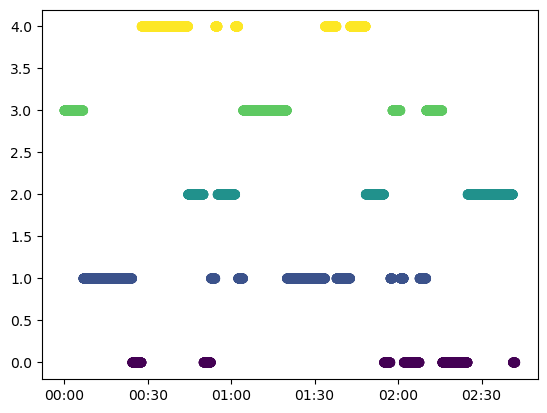

In [8]:
xdata_seconds = librosa.times_like(mfccs_T)
x = [datetime.timedelta(seconds=xi) for xi in xdata_seconds]
x_time = [str(xi) for xi in x]
# fig1, ax1 = plt.subplots()
# ax1.plot(x_time,clusters)
#doesnt work with scatterplot?

x_time = [datetime.datetime(year=9999,month=1,day=1,hour=0)+ datetime.timedelta(seconds=i) for i in xdata_seconds]

y = clusters
fig2, ax2 = plt.subplots()
date_form = DateFormatter("%M:%S")
ax2.xaxis.set_major_formatter(date_form)
ax2.scatter(x_time,y,c=y)

In [9]:
# 85 bpm


In [10]:
sr

22050